Clustering is a difficult topic to address because unlike regression, classification, etc. there isn't an obvious goal. Typically it's an exploratory technique.

In this lab, we'll be clustering pixels in images. People have different goals when they do this.
1. To compress the image. If we cluster pixels by color, we can compress the image into the cluster centers [which are typically 256-bit colors after rounding]
and a cluster indicator for each pixel [which are $\log_2(number of clusters)$ bits per pixel]. While there are better, more sophisticated ways to compress images, these can look good and give a dramatic reduction in image size.
2. To segment the image into [what are hopefully] objects. For this task, we may want to take into account pixel location as well as color, as neighboring, like-colored pixels tend to be in the same object.

Pixel clustering is illustrative of several important phenomena.
1. It is often important to pay as much attention to the degree of similarity between clusters as it is to the individual. For example,
if we cluster pixels by color and then draw the image giving pixels all the pixels in each cluster the same arbitrary color, it may not be possible to understand the resulting image. If we color them by the cluster center or even by essentially any continuous function of the cluster center, we will typically be able to understand it.
2. There is reasonable cluster structure at multiple scales. While there has been some attention to finding the right number of clusters, typically the right number depends on what you're trying to do. And we don't usually get what we think we should. Generally when we try to cluster on a coarse scale, we put what appear to group together what we visually perceive to be different objects. When we try to cluster on a fine scale, we chop up objects we perceive to be the same into multiple pieces. In the middle, we'll usually do both.
3. The features we put in come out. For example, while we generally think clusters of pixels should be spacially contiguous because objects in images are, if we cluster pixels encoded simply as colors, we'll only get this insofar as different regions of the image are distinct colors.

Much more so than prediction [regression or classification] methods, clustering is sensitive to the features you use and the way that they're scaled. That's because when we fit predictive models, the parameters we estimate adapt to the scale of the features *relevant to the prediction task*. In clustering, there's no clear task to adapt to. We get what we put in.

We'll use finite mixtures of gaussians to cluster.

To explore the clustering in 3-dimensional [RGB] color space,
we'll be using interactive 3D Plots generated by the package *plotly*.
If you're not able to install the package, the distributed HTML version,
which I've generated simply by saving this notebook, includes saved versions of these plots which are still interactive.

In [2]:
from scipy import misc
import numpy as n
import sklearn.mixture
import matplotlib.pyplot as plt
from plotly import offline
import plotly.graph_objs as go

%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 10]
offline.init_notebook_mode()

In the plots generated by the following cell, we cluster pixels by color
as 3-dimensional RGB vectors. We use Gaussian mixtures, allow each cluster to have its own $3 \times 3$ covariance matrix. 
We cluster at multiple scales: 2,4,10, and 30 clusters. In the left column, we see the original image. In the center, the *quantized* version where each pixel in a cluster is assigned one color, the cluster center. On the right, we randomly re-assign colors to each cluster to get a sense of what position we'd be in if we ignored similarity between clusters.

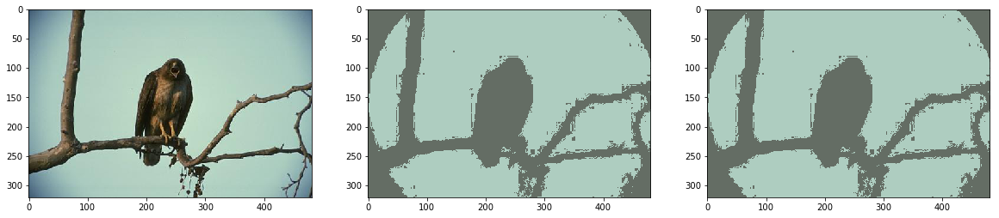

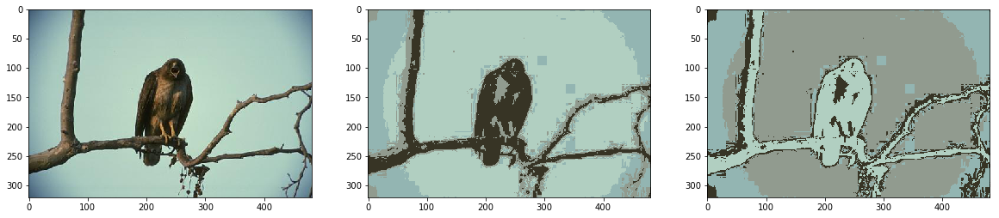

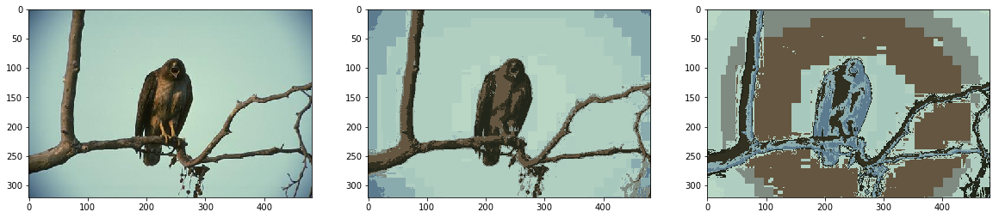

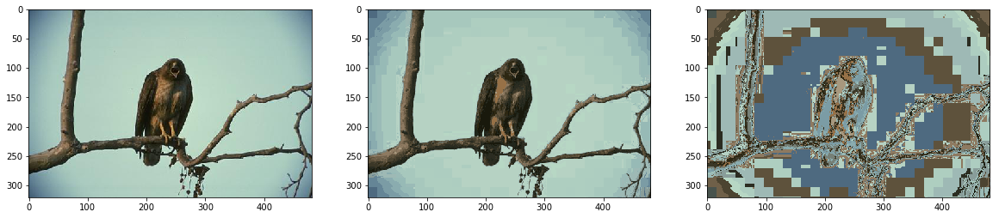

In [3]:
def as_pixels(im):
    return im.reshape((im.shape[0]*im.shape[1], im.shape[2]))
def as_image_like(labels, im):
    return labels.reshape((im.shape[0],im.shape[1]) + labels.shape[1:])
def quantize(im, mixture, permute_colors=False):
    labels = mixture.predict(as_pixels(im))
    means = mixture.means_[:,:3].astype('uint8')
    if permute_colors:
        means = means[n.random.permutation(mixture.n_components), :]
    return as_image_like(means[labels,:], im)
 
n.random.seed(0)
im=misc.imread('bird.jpg')
for k in [2,4,10,30]:
    mixture = sklearn.mixture.GaussianMixture(k).fit(as_pixels(im))
    plt.figure() 
    plt.title(f'{mixture.n_components} clusters. image (left), quantized colors (center), random colors (right)')
    plt.subplot(1,3,1); plt.imshow(im)
    plt.subplot(1,3,2); plt.imshow(quantize(im, mixture))
    plt.subplot(1,3,3); plt.imshow(quantize(im, mixture, permute_colors=True))

To explore the clustering in more detail, we will plot the points in 3-dimensional RGB space. We'll use 4 clusters. There are six plots.

1. A sample of the pixels in all clusters, colored by the mean color of the cluster. 
2. The same as (1), but whitened [transformed to have identity covariance] to make the differences between clusters easier to see.
3. A sample of the points in the first cluster, colored
by their individual color. This should give you a sense of the heterogeneity within each cluster. These are whitened using the cluster-specific covariance.

Plots 4-6 are like (3) but for clusters 2-4. 

You can rotate by clicking and dragging and zoom by scrolling while hovering over the plot. To scroll through the plots, scroll with your pointer to the right of the plots.

In [23]:
def scatter(pixels, labels, mixture, whiten_cluster=None):
   if n.all(labels==labels[0]):
       colors=n.array(["rgb(%f,%f,%f)" % tuple(p) for p in pixels.astype('uint8')])
   else:
       cluster_colors=n.array(["rgb(%f,%f,%f)" % tuple(m) for m in mixture.means_.astype('uint8')])
       colors = cluster_colors[labels]
   if whiten_cluster is None:
       cov = n.eye(3)
   elif whiten_cluster == 'pooled':
       cov = n.cov(pixels.T)
   elif mixture.covariance_type == 'full':
       cov = mixture.covariances_[whiten_cluster]
   elif mixture.covariance_type == 'tied':
        cov = mixture.covariances_
   elif mixture.covariance_type == 'diag':
        cov = n.diag(mixture.covariances_[whiten_cluster])
   elif mixture.covariance_type == 'spherical':
        cov = n.eye(3)*mixture.covariances_[whiten_cluster]
   whitening_transformation = n.linalg.cholesky(n.linalg.inv(cov))
   white_px = n.dot(pixels, whitening_transformation)
   return go.Scatter3d(x=white_px[:,0], y=white_px[:,1], z=white_px[:,2],
                 mode='markers', marker=dict(size=4, color=colors))

im = misc.imread('bird.jpg')
mixture = sklearn.mixture.GaussianMixture(4).fit(as_pixels(im))
def plot_components(mixture, im, thin_to=5000):
    pixels = as_pixels(im)
    labels = mixture.predict(pixels)
    n.random.seed(0)
    
    thin = n.random.permutation(pixels.shape[0]) < thin_to
    fig = go.Figure(data=[scatter(pixels[thin,:], labels[thin], mixture, whiten_cluster=None)]); offline.iplot(fig)
    fig = go.Figure(data=[scatter(pixels[thin,:], labels[thin], mixture, whiten_cluster='pooled')]); offline.iplot(fig)
    for cc in range(mixture.n_components):
        thin = n.nonzero(labels==cc)[0]
        n.random.shuffle(thin)
        thin=thin[:thin_to]
        fig = go.Figure(data=[scatter(pixels[thin,:], 
                                      labels[thin], mixture, whiten_cluster=cc)]) 
        offline.iplot(fig)

mixture = sklearn.mixture.GaussianMixture(4,  covariance_type='full').fit(as_pixels(im))
plot_components(mixture, im)

In the next two cells, we repeat the example above, but restricting the
mixture of gaussians we fit to have spherical [scaled identity]
covariance matrices. You can see in the unwhitened plot (1) above, the 
actual covariances are far from spherical. Because the model is a poor fit, the clusters are more heterogeneous than those above.

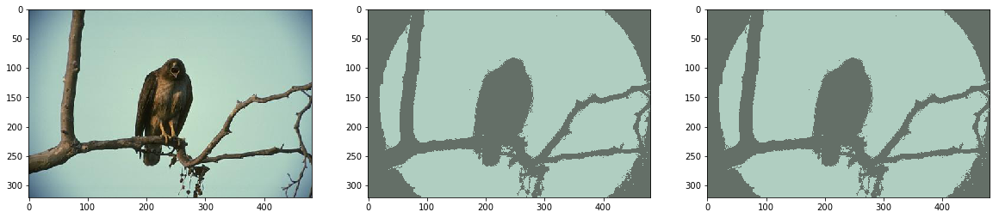

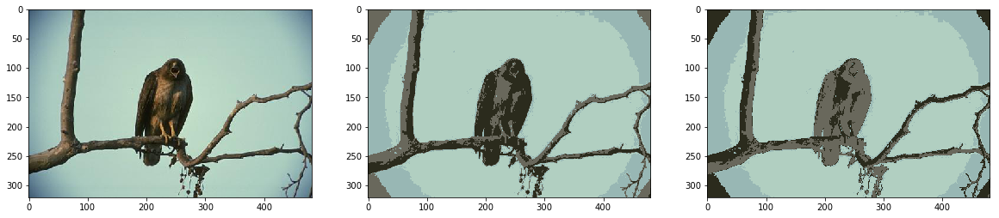

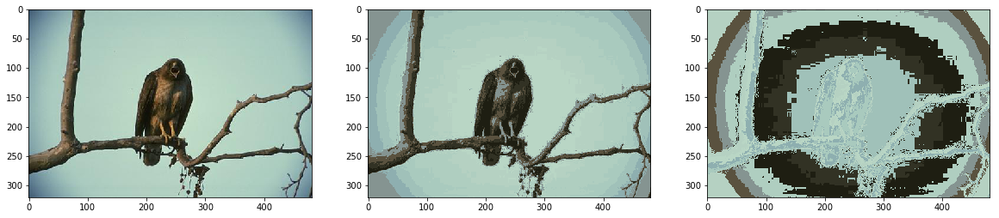

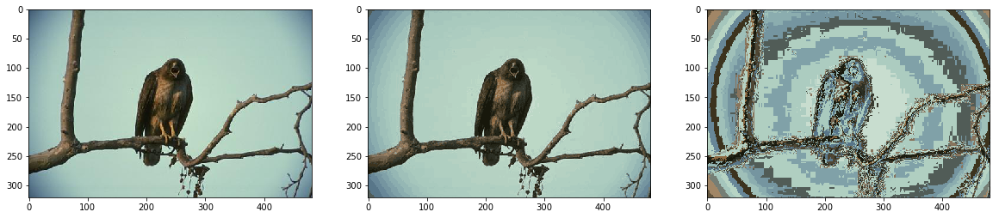

In [11]:
im=misc.imread('bird.jpg')
for k in [2,4,10,30]:
    mixture = sklearn.mixture.GaussianMixture(k, covariance_type='spherical').fit(as_pixels(im))
    plt.figure() 
    plt.title(f'{mixture.n_components} clusters. image (left), quantized colors (center), random colors (right)')
    plt.subplot(1,3,1); plt.imshow(im)
    plt.subplot(1,3,2); plt.imshow(quantize(im, mixture))
    plt.subplot(1,3,3); plt.imshow(quantize(im, mixture, permute_colors=True))

In [13]:
mixture = sklearn.mixture.GaussianMixture(4,  covariance_type='spherical').fit(as_pixels(im))
plot_components(mixture, im)

The bird image above was fairly simple. It had sky, a tree, a bird, and some shadow around the edges. Here we're going to repeat our analysis
[using full covariate structure] on a new image. 

Here the lighting tends to make different areas of objects, even if they are the same material, have different colors in the image. Clustering using color alone doesn't seem to identify objects in the image. It works best in regions of the image where the color changes in lighting are slow, like the sky and grass.

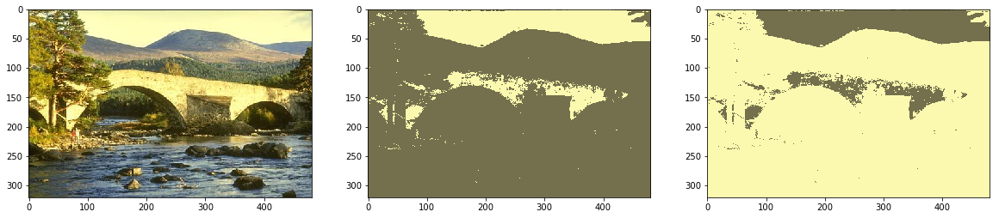

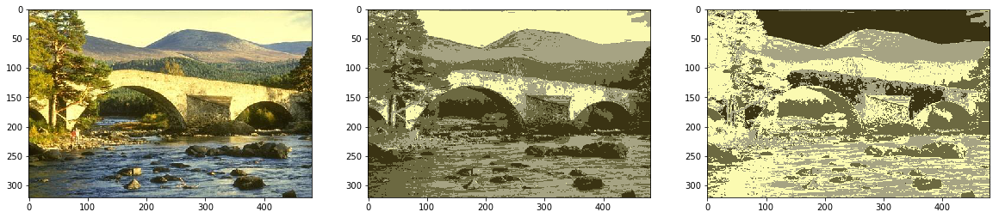

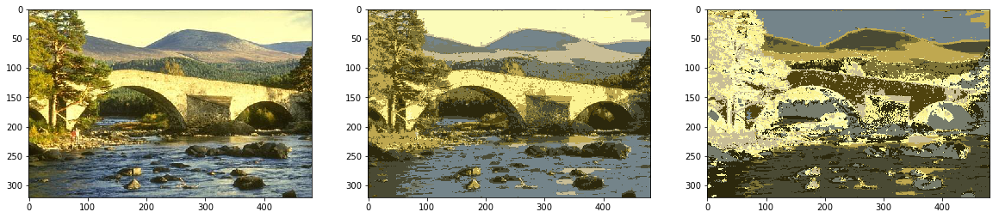

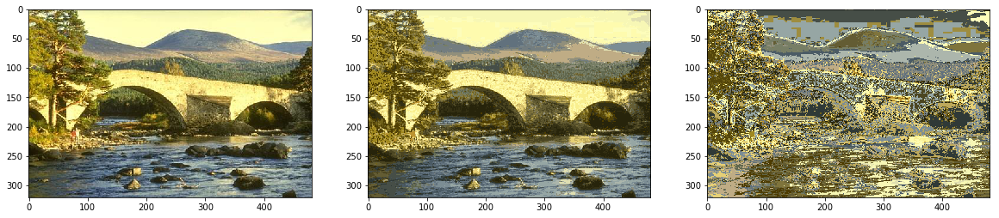

In [14]:
im=misc.imread('bridge.jpg')
for k in [2,4,10,30]:
    mixture = sklearn.mixture.GaussianMixture(k).fit(as_pixels(im))
    plt.figure() 
    plt.title(f'{mixture.n_components} clusters. image (left), quantized colors (center), random colors (right)')
    plt.subplot(1,3,1); plt.imshow(im)
    plt.subplot(1,3,2); plt.imshow(quantize(im, mixture))
    plt.subplot(1,3,3); plt.imshow(quantize(im, mixture, permute_colors=True))

In [15]:
im = misc.imread('bridge.jpg')
mixture = sklearn.mixture.GaussianMixture(4).fit(as_pixels(im))
plot_components(mixture, im)

To improve the clustering, we will include pixel location in the set of features we use to cluster them. Each pixel is represented as a 5-dimensional vector [X,Y,R,G,B]. 

As you might expect, we get more spacial continuity in our clusters. However, this introduces artifacts as well. In some cases, objects of similar colors are broken up simply because they're big and their XY coordinates have changed a lot.

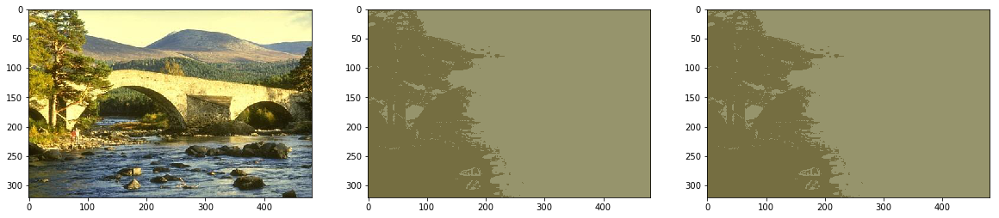

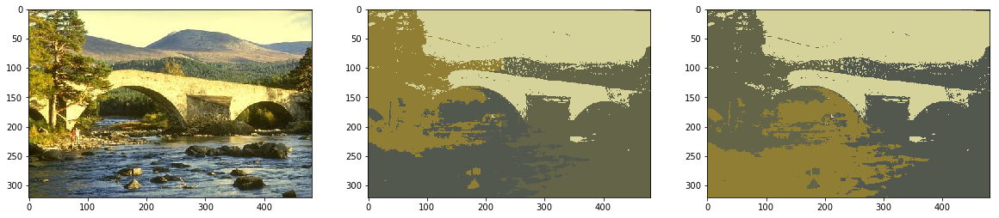

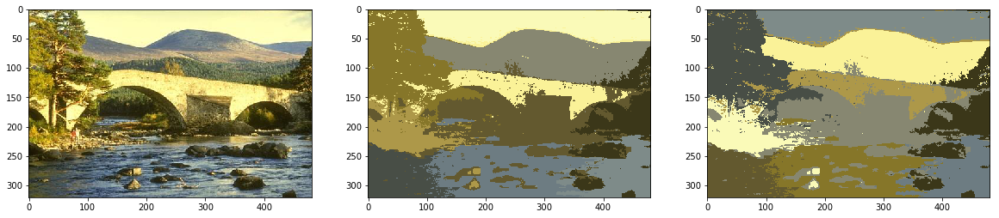

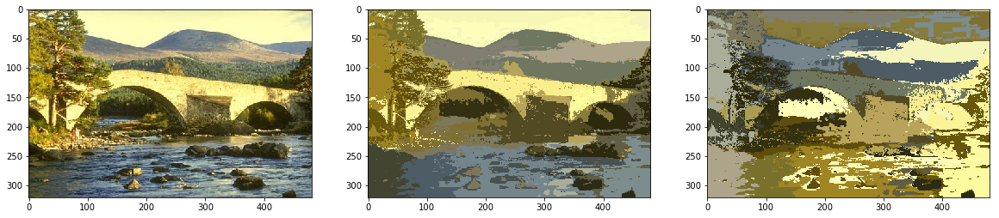

In [18]:
bridge = misc.imread('bridge.jpg')
im=bridge
grid = n.mgrid[:im.shape[0], :im.shape[1]].transpose([1,2,0])
feature_im = n.concatenate((im,grid),axis=2)

for k in [2,4,10,30]:
    mixture = sklearn.mixture.GaussianMixture(k, covariance_type='full').fit(as_pixels(feature_im))
    plt.figure() 
    plt.title(f'{mixture.n_components} clusters. image (left), quantized colors (center), random colors (right)')
    plt.subplot(1,3,1); plt.imshow(im)
    plt.subplot(1,3,2); plt.imshow(quantize(feature_im, mixture))
    plt.subplot(1,3,3); plt.imshow(quantize(feature_im, mixture, permute_colors=True))

We repeat this using Gaussian mixtures with spherical covariance. This doesn't work as well. 
Large and consistently colored objects like the sky are broken up. When we used mixtures with full covariance previously, the Gaussians we fit were elongated in the directions in which the X,Y coordinates of large objects like the sky varied. If we assume spherical covariance, this isn't allowed to happen. 

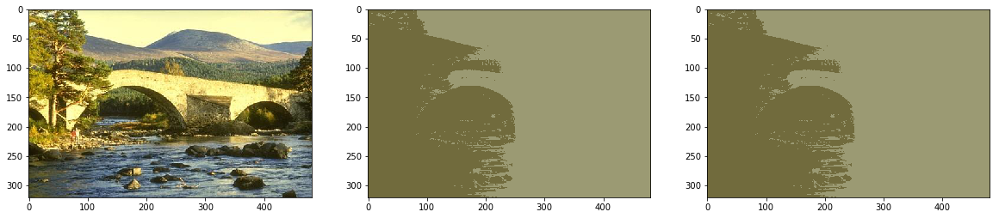

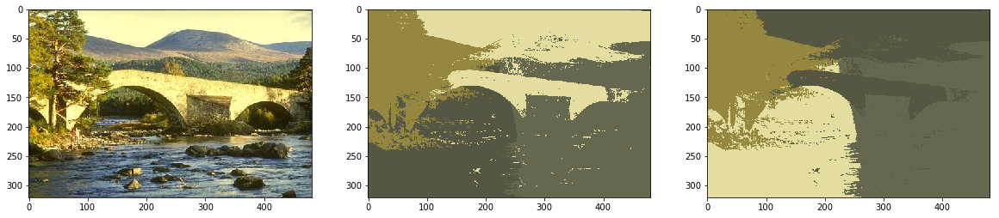

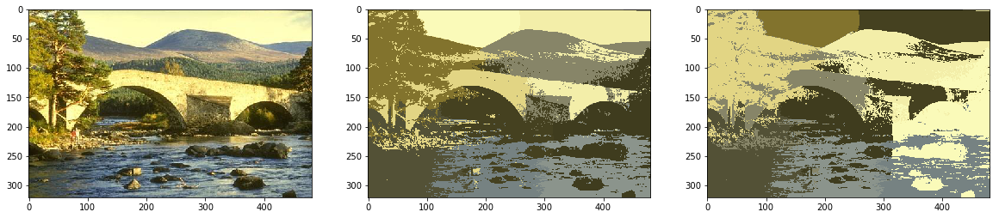

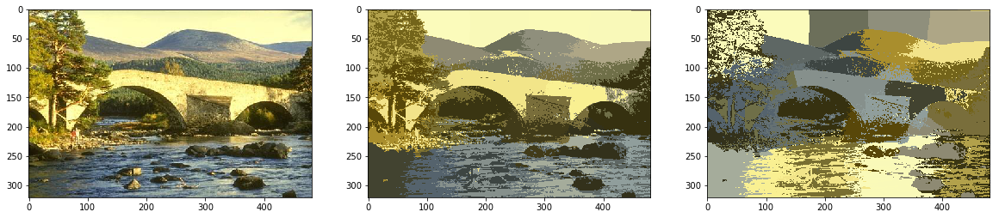

In [19]:
bridge = misc.imread('bridge.jpg')
im=bridge
grid = n.mgrid[:im.shape[0], :im.shape[1]].transpose([1,2,0])
feature_im = n.concatenate((im,grid),axis=2)

for k in [2,4,10,30]:
    mixture = sklearn.mixture.GaussianMixture(k, covariance_type="spherical").fit(as_pixels(feature_im))
    plt.figure() 
    plt.title(f'{mixture.n_components} clusters. image (left), quantized colors (center), random colors (right)')
    plt.subplot(1,3,1); plt.imshow(im)
    plt.subplot(1,3,2); plt.imshow(quantize(feature_im, mixture))
    plt.subplot(1,3,3); plt.imshow(quantize(feature_im, mixture, permute_colors=True))

We can encode pixel location in more than one way. Next, instead of augmenting the RGB coordinates with
XY coordinates, we augment them with an 6-dimensional vector that is informative about location:
the distances to 6 random locations in the image. As currently tuned, it doesn't seem to work terribly well.

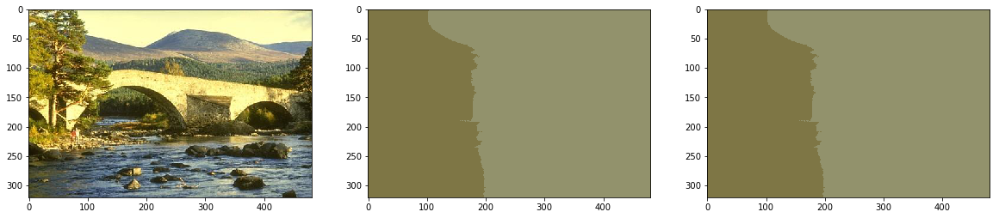

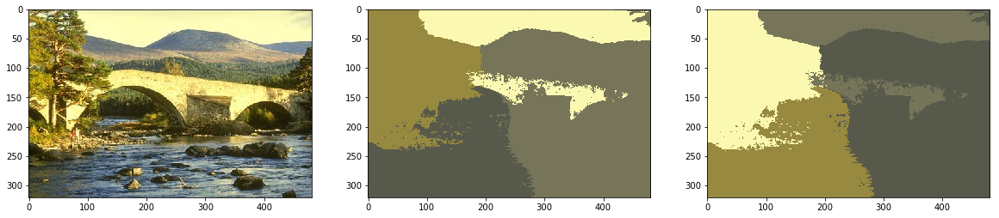

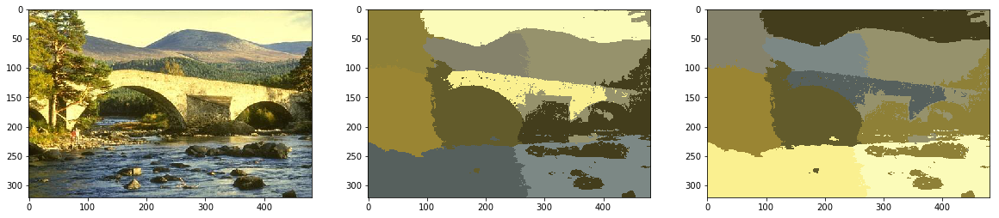

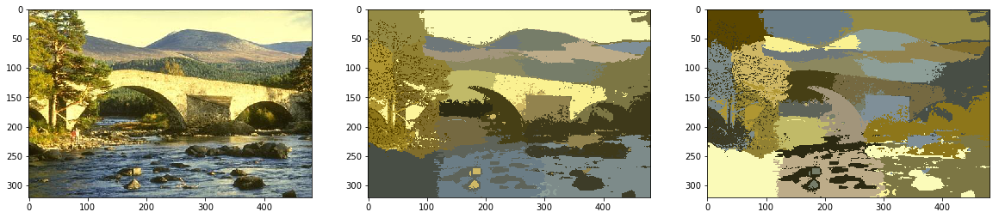

In [22]:
bridge = misc.imread('bridge.jpg')
im=bridge

grid = n.mgrid[:im.shape[0], :im.shape[1]].transpose([1,2,0])
n.random.seed(0)
random_i=n.random.permutation(im.shape[0])[1:6]
random_j=n.random.permutation(im.shape[1])[1:6]

distances = [n.atleast_3d(n.sqrt((grid[:,:,0]-ii)**2 + (grid[:,:,1]-jj)**2))/5000 for (ii,jj) in zip(random_i, random_j)]
feature_im = n.concatenate([im] + distances, axis=2)

for k in [2,4,10,30]:
    mixture = sklearn.mixture.GaussianMixture(k).fit(as_pixels(feature_im))
    plt.figure() 
    plt.title(f'{mixture.n_components} clusters. image (left), quantized colors (center), random colors (right)')
    plt.subplot(1,3,1); plt.imshow(im)
    plt.subplot(1,3,2); plt.imshow(quantize(feature_im, mixture))
    plt.subplot(1,3,3); plt.imshow(quantize(feature_im, mixture, permute_colors=True))

Exercise 1.
Can you find and tune a set of features resulting in a good clustering of pixels in this image? Consider
- Converting from RGB to different color spaces. For example, HSV.
- Smoothing over bright spots in the image caused by reflected light by using, for each pixel, an average of the colors around it as a feature. The function *scipy.misc.imfilter* may be helpful.
- Representing pixel location in other ways.

Exercise 2. 
See what happens when you use another image. You should be able to substitute in the code the filename of an image in any standard format.